---------------------------------------------------------------------------
#Data Science Mini Project
---------------------------------------------------------------------------


ID - a25sanvu

### The Aim of my Mini Project is which Movie Features like **Budget, Genre, Release year, Vote count** etc which of these mostly influence **Movie's Revenue**.
---------------------------------------------------------------------------






I have Choosen the Dataset from **Kaggle -** **Movie Dataset for Analytics & Visualization**

This dataset contains 999,999 rows of synthetic movie data designed to simulate real-world movie industry metrics and characteristics, with a variety of numeric, categorical, and date fields.


*   Movies span from 1950 through 2025, with random release dates generated within each release year.

*   Contains 8 major genres (Drama, Action, Comedy, Thriller, Romance, Sci-Fi, Horror, Documentary) distributed realistically.


*   Detailed financial data including production budgets, US box office revenue, and global box office revenue, alongside opening day and first week US sales.

*   Audience engagement data reflected by IMDb ratings, Rotten Tomatoes scores, and corresponding user vote counts on both platforms.


*   Contains realistic correlations such as budget impacting box office earnings, box office affecting sales figures, and ratings correlating with vote counts.










On this Dataset I am Planning to implement all major stages of the Data Science Life Cycle:


1.   Hypothesis / Problem Definition
2.   Data Collection
3.   Data Cleaning
4.   Feature Engineering
5.   EDA
6.   Model Building & Training
7.   Model evaluation
8.   Visualization of Results



After Understanding completely about the dataset i have finalized my Hypothesis for this dataset and that is

1. **Hypothesis** - **Which movie features most strongly influence movie revenue?**

In [1]:
#importing the basic libraries to run the project
import pandas as pd
import numpy as np

2. **Data collection** - I have collected this dataset from (kaggle) **Movie Dataset for Analytics & Visualization**

*Loading* Dataset Using Google Drive File ID As the Dataset is Large.

In [2]:
! gdown --id 1NiywzVfVtcMil0sxkIsLL_Vh7XBXr62e

/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:139: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1NiywzVfVtcMil0sxkIsLL_Vh7XBXr62e
From (redirected): https://drive.google.com/uc?id=1NiywzVfVtcMil0sxkIsLL_Vh7XBXr62e&confirm=t&uuid=583470a4-68ed-4486-8819-a4e87b061ed8
To: /content/movies_dataset.csv
100% 151M/151M [00:02<00:00, 66.5MB/s]


In [3]:
#assigning the path

path = '/content/movies_dataset.csv'

df = pd.read_csv(path)


In [4]:
#inspecting the data
df.info()
print("\n")
df.head()

df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999999 entries, 0 to 999998
Data columns (total 17 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   MovieID               999999 non-null  int64  
 1   Title                 999999 non-null  object 
 2   Genre                 999999 non-null  object 
 3   ReleaseYear           999999 non-null  int64  
 4   ReleaseDate           999999 non-null  object 
 5   Country               999999 non-null  object 
 6   BudgetUSD             999999 non-null  float64
 7   US_BoxOfficeUSD       999999 non-null  float64
 8   Global_BoxOfficeUSD   999999 non-null  float64
 9   Opening_Day_SalesUSD  999999 non-null  float64
 10  One_Week_SalesUSD     999999 non-null  float64
 11  IMDbRating            999999 non-null  float64
 12  RottenTomatoesScore   999999 non-null  int64  
 13  NumVotesIMDb          999999 non-null  int64  
 14  NumVotesRT            999999 non-null  int64  
 15  

,MovieID,ReleaseYear,BudgetUSD,US_BoxOfficeUSD,Global_BoxOfficeUSD,Opening_Day_SalesUSD,One_Week_SalesUSD,IMDbRating,RottenTomatoesScore,NumVotesIMDb,NumVotesRT
count,999999.000000,999999.000000,9.999990e+05,9.999990e+05,9.999990e+05,9.999990e+05,9.999990e+05,999999.000000,999999.000000,999999.000000,999999.000000
mean,500000.000000,1998.001220,9.802824e+06,1.496163e+07,2.720625e+07,2.992745e+06,7.483442e+06,6.494788,64.776426,9137.184011,2031.880340
std,288674.990255,19.260863,2.249421e+07,3.879403e+07,6.954294e+07,8.132438e+06,1.955337e+07,1.485606,17.592474,24922.362780,8433.380602
min,1.000000,1950.000000,1.000000e+05,4.002547e+04,1.000000e+05,4.050470e+03,1.650742e+04,1.000000,0.000000,100.000000,50.000000
25%,250000.500000,1984.000000,1.190511e+06,1.489805e+06,2.762370e+06,2.790262e+05,7.383145e+05,5.500000,53.000000,1083.000000,119.000000
50%,500000.000000,2001.000000,3.265790e+06,4.388876e+06,8.090223e+06,8.387221e+05,2.179436e+06,6.500000,65.000000,2983.000000,405.000000
75%,749999.500000,2014.000000,9.002791e+06,1.287606e+07,2.355245e+07,2.510360e+06,6.415143e+06,7.500000,77.000000,8192.000000,1360.000000
max,999999.000000,2025.000000,3.000000e+08,1.018198e+09,1.499497e+09,2.957511e+08,5.795551e+08,10.000000,100.000000,1000000.000000,500000.000000


In [5]:
df.shape

(999999, 17)

This dataset has 9,99,999 Rows and 17 columns

3. **Data Cleaning**

In [6]:
# Removing duplicates
print("Shape before dropping duplicates:", df.shape)
df.drop_duplicates(inplace=True)
print("Shape after dropping duplicates:", df.shape)

# Columns which are not needed for my prediction
irrelevant_cols = [
    'MovieID',
    'ReleaseYear',
    'IMDbRating',
    'RottenTomatoesScore'
]

# columns on which i will be predicting on
protected_cols = [
    'BudgetUSD',
    'Global_BoxOfficeUSD',
    'Opening_Day_SalesUSD',
    'One_Week_SalesUSD',
    'NumVotesIMDb',
    'NumVotesRT',
    'Release_Year',
    'Genre',
    'Country',
    'Director',
    'LeadActor'
]

# Final columns to drop
cols_to_drop = [col for col in irrelevant_cols if col in df.columns and col not in protected_cols]

# Dropping
df.drop(columns=cols_to_drop, inplace=True, errors='ignore')

print("Columns remaining:", df.columns.tolist())

Shape before dropping duplicates: (999999, 17)
Shape after dropping duplicates: (999999, 17)
Columns remaining: ['Title', 'Genre', 'ReleaseDate', 'Country', 'BudgetUSD', 'US_BoxOfficeUSD', 'Global_BoxOfficeUSD', 'Opening_Day_SalesUSD', 'One_Week_SalesUSD', 'NumVotesIMDb', 'NumVotesRT', 'Director', 'LeadActor']


In [7]:
# Showing total missing values per column, sorting highest to lowest
df.isnull().sum().sort_values(ascending=False)


,0
Title,0
Genre,0
ReleaseDate,0
Country,0
BudgetUSD,0
US_BoxOfficeUSD,0
Global_BoxOfficeUSD,0
Opening_Day_SalesUSD,0
One_Week_SalesUSD,0
NumVotesIMDb,0


In [8]:
# Initiating DataCleaning

# Checking for missing values
df.isnull().sum().sum()

# Checking for duplicates
df.duplicated().sum()



np.int64(0)

After Performing **Data Cleaning** there were no missing values and  Duplicate rows were dropped.


In [9]:
print(df.columns.tolist())


['Title', 'Genre', 'ReleaseDate', 'Country', 'BudgetUSD', 'US_BoxOfficeUSD', 'Global_BoxOfficeUSD', 'Opening_Day_SalesUSD', 'One_Week_SalesUSD', 'NumVotesIMDb', 'NumVotesRT', 'Director', 'LeadActor']


After reviewing the columns, I decided NOT to drop any columns because all are useful for analysis or modeling.


In [10]:
#Converting ReleaseDate to Datetime Format

# Converting ReleaseDate from string format to datetime format which will be useful while performing Data Analysis
df['ReleaseDate'] = pd.to_datetime(df['ReleaseDate'], errors='coerce')


df['ReleaseDate'].head(10)


/tmp/ipython-input-1856035995.py:4: UserWarning: Parsing dates in %d-%m-%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  df['ReleaseDate'] = pd.to_datetime(df['ReleaseDate'], errors='coerce')


,ReleaseDate
0,2003-09-28
1,1988-02-14
2,1971-11-02
3,1998-08-06
4,2021-12-17
5,1996-05-09
6,1991-09-24
7,1990-08-04
8,1983-03-12
9,2005-09-06


In [11]:
# # Separating all the components from ReleaseDate Like Release Month, Year and Day
df['Release_Year'] = df['ReleaseDate'].dt.year
df['Release_Month'] = df['ReleaseDate'].dt.month
df['Release_Day'] = df['ReleaseDate'].dt.day

# Separating all the components from Releasedata like Release month, year and day
df['ReleaseDate'] = pd.to_datetime(df['ReleaseDate'], errors='coerce')
df['Release_Year'] = df['ReleaseDate'].dt.year

missing_dates = df['ReleaseDate'].isna().sum()
print(f"Missing/invalid release dates: {missing_dates}")


df[['ReleaseDate', 'Release_Year', 'Release_Month', 'Release_Day']].head(10)


Missing/invalid release dates: 0


,ReleaseDate,Release_Year,Release_Month,Release_Day
0,2003-09-28,2003,9,28
1,1988-02-14,1988,2,14
2,1971-11-02,1971,11,2
3,1998-08-06,1998,8,6
4,2021-12-17,2021,12,17
5,1996-05-09,1996,5,9
6,1991-09-24,1991,9,24
7,1990-08-04,1990,8,4
8,1983-03-12,1983,3,12
9,2005-09-06,2005,9,6


For my Further Analysis i wanted to check the profits and the Return of Investment of Each Genre

**4.** **Feature Engineering**

In [12]:
# Adding Feature Engineering
# Creating 2 new columns profit and ROI such that This shows us Financial Performance
df['profit'] = df['Global_BoxOfficeUSD'] - df['BudgetUSD']
#df['roi'] = (df['Global_BoxOfficeUSD'] - df['BudgetUSD']) / df['BudgetUSD']
df['roi'] = df.apply(lambda r: (r['profit'] / r['BudgetUSD']) if pd.notna(r['BudgetUSD']) and r['BudgetUSD'] != 0 else np.nan, axis=1)


display(df[['BudgetUSD', 'Global_BoxOfficeUSD', 'profit', 'roi']].head(15))

,BudgetUSD,Global_BoxOfficeUSD,profit,roi
0,6577427.79,15472035.66,8894607.87,1.352293
1,1883810.10,3637731.12,1753921.02,0.931050
2,2468079.29,7165111.24,4697031.95,1.903112
3,1447311.46,4373820.26,2926508.80,2.022031
4,900915.86,3113017.38,2212101.52,2.455392
5,6356058.11,12332192.70,5976134.59,0.940227
6,30881640.04,61633322.70,30751682.66,0.995792
7,5249748.92,6059156.85,809407.93,0.154180
8,4746218.15,9506139.90,4759921.75,1.002887
9,1354686.21,6747065.42,5392379.21,3.980537


In [13]:
# Movie age feature
df['movie_age'] = 2025 - df['Release_Year']
display(df[['movie_age']].head())

,movie_age
0,22
1,37
2,54
3,27
4,4


In [14]:
display(df.head())

,Title,Genre,ReleaseDate,Country,BudgetUSD,US_BoxOfficeUSD,Global_BoxOfficeUSD,Opening_Day_SalesUSD,One_Week_SalesUSD,NumVotesIMDb,NumVotesRT,Director,LeadActor,Release_Year,Release_Month,Release_Day,profit,roi,movie_age
0,Might toward capital,Comedy,2003-09-28,China,6577427.79,6613685.82,15472035.66,1778530.85,3034053.32,7865,10596,Kristina Moore,Brian Mccormick,2003,9,28,8894607.87,1.352293,22
1,He however experience,Comedy,1988-02-14,USA,1883810.10,1930949.15,3637731.12,247115.74,831828.84,1708,220,Benjamin Hudson,Ashley Pena,1988,2,14,1753921.02,0.931050,37
2,Star responsibility politics,Comedy,1971-11-02,USA,2468079.29,4186694.69,7165111.24,878453.95,2171405.93,4678,7805,Kayla Young,Alexander Haley,1971,11,2,4697031.95,1.903112,54
3,Exactly live,Comedy,1998-08-06,USA,1447311.46,2023683.92,4373820.26,570657.72,898886.01,2467,1751,Michael Ross,Patrick Barnett,1998,8,6,2926508.80,2.022031,27
4,Focus improve especially,Documentary,2021-12-17,India,900915.86,2129629.10,3113017.38,361189.37,861775.91,5555,697,Faith Franklin,Duane Fletcher DDS,2021,12,17,2212101.52,2.455392,4


**5.** **Exploring Data Analysis(EDA)**

This pie chart shows the proportion of movies in each genre.  

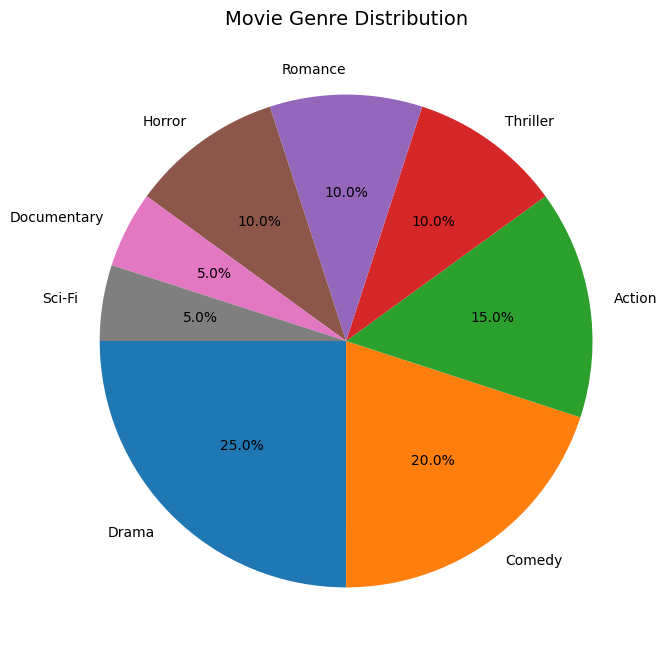

Number of movies by genre:
Genre
Drama          250018
Comedy         199832
Action         150131
Thriller       100071
Romance        100021
Horror         100010
Documentary     50114
Sci-Fi          49802
Name: count, dtype: int64


In [15]:
import matplotlib.pyplot as plt

# Counts the number of movies per genre
genre_counts = df['Genre'].value_counts()

# pie chart
plt.figure(figsize=(8,8))
plt.pie(
    genre_counts,
    labels=genre_counts.index,
    autopct='%1.1f%%',          # Show percentage values
    startangle=180,

)
plt.title("Movie Genre Distribution", fontsize=14)
plt.show()

# Display counts
print("Number of movies by genre:")
print(genre_counts)


In [16]:
# Checking the shape and summary
print("Shape of dataset:", df.shape)
df.describe(include='all')


Shape of dataset: (999999, 19)


,Title,Genre,ReleaseDate,Country,BudgetUSD,US_BoxOfficeUSD,Global_BoxOfficeUSD,Opening_Day_SalesUSD,One_Week_SalesUSD,NumVotesIMDb,NumVotesRT,Director,LeadActor,Release_Year,Release_Month,Release_Day,profit,roi,movie_age
count,999999,999999,999999,999999,9.999990e+05,9.999990e+05,9.999990e+05,9.999990e+05,9.999990e+05,999999.000000,999999.000000,999999,999999,999999.000000,999999.000000,999999.000000,9.999990e+05,999999.000000,999999.000000
unique,9665,8,NaN,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,150,299,NaN,NaN,NaN,NaN,NaN,NaN
top,With,Drama,NaN,USA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Tara Underwood,Jeffrey Smith,NaN,NaN,NaN,NaN,NaN,NaN
freq,506,250018,NaN,714581,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6898,6688,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,1998-07-02 09:21:58.238518144,NaN,9.802824e+06,1.496163e+07,2.720625e+07,2.992745e+06,7.483442e+06,9137.184011,2031.880340,NaN,NaN,1998.001220,6.521019,15.729277,1.740343e+07,1.778474,26.998780
min,NaN,NaN,1950-01-01 00:00:00,NaN,1.000000e+05,4.002547e+04,1.000000e+05,4.050470e+03,1.650742e+04,100.000000,50.000000,NaN,NaN,1950.000000,1.000000,1.000000,0.000000e+00,0.000000,0.000000
25%,NaN,NaN,1984-08-17 00:00:00,NaN,1.190511e+06,1.489805e+06,2.762370e+06,2.790262e+05,7.383145e+05,1083.000000,119.000000,NaN,NaN,1984.000000,4.000000,8.000000,8.291324e+05,0.625781,11.000000
50%,NaN,NaN,2001-09-09 00:00:00,NaN,3.265790e+06,4.388876e+06,8.090223e+06,8.387221e+05,2.179436e+06,2983.000000,405.000000,NaN,NaN,2001.000000,7.000000,16.000000,3.971480e+06,1.751358,24.000000
75%,NaN,NaN,2014-11-20 00:00:00,NaN,9.002791e+06,1.287606e+07,2.355245e+07,2.510360e+06,6.415143e+06,8192.000000,1360.000000,NaN,NaN,2014.000000,10.000000,23.000000,1.394296e+07,2.876229,41.000000
max,NaN,NaN,2025-12-31 00:00:00,NaN,3.000000e+08,1.018198e+09,1.499497e+09,2.957511e+08,5.795551e+08,1000000.000000,500000.000000,NaN,NaN,2025.000000,12.000000,31.000000,1.199497e+09,3.999999,75.000000


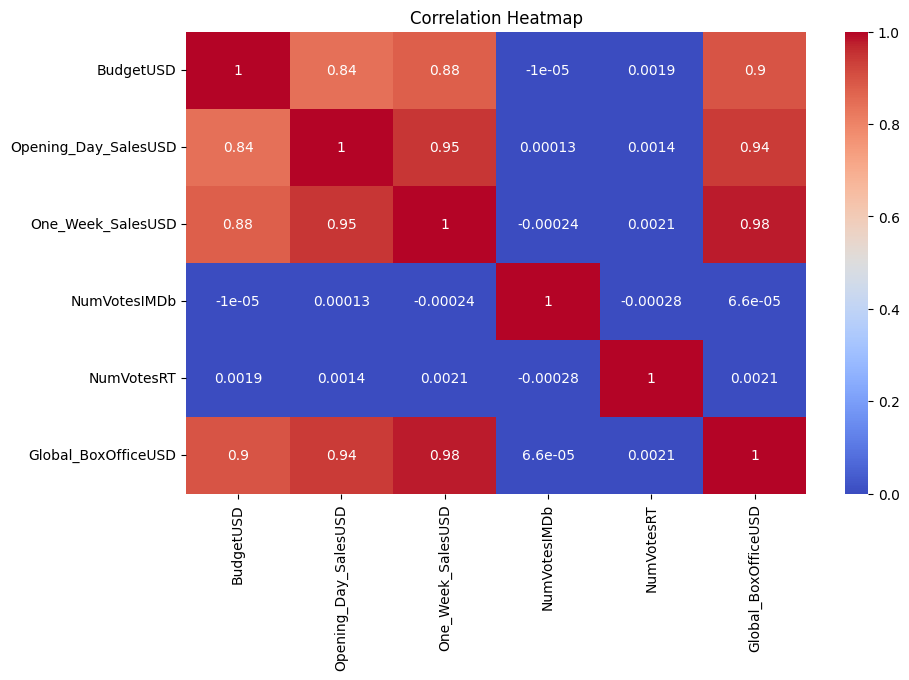

In [17]:

# correlation heatmap

import seaborn as sns
plt.figure(figsize=(10,6))
sns.heatmap(df[['BudgetUSD','Opening_Day_SalesUSD','One_Week_SalesUSD',
                'NumVotesIMDb','NumVotesRT','Global_BoxOfficeUSD']].corr(),
            annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()


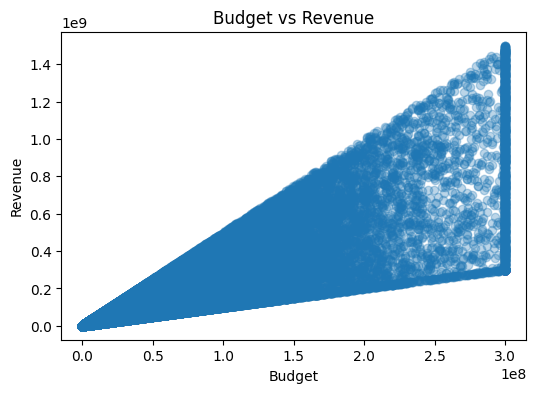

In [18]:
# scatter plot

plt.figure(figsize=(6,4))
plt.scatter(df['BudgetUSD'], df['Global_BoxOfficeUSD'], alpha=0.3)
plt.xlabel("Budget")
plt.ylabel("Revenue")
plt.title("Budget vs Revenue")
plt.show()



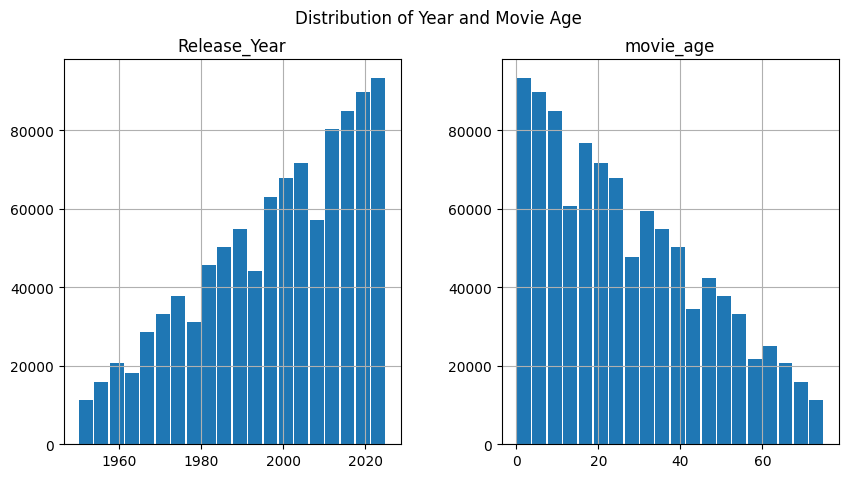

In [19]:
import matplotlib.pyplot as plt

# Plot histograms for Release Year and Movie age
df[['Release_Year', 'movie_age']].hist(bins=20, figsize=(10,5),rwidth=0.9 )
plt.suptitle("Distribution of Year and Movie Age")
plt.show()


#scatter plot
import plotly.express as px


fig = px.scatter(
    df,
    x="Release_Year",
    y="movie_age",
    title="Release Year vs Movie Age",
    labels={"Release_Year": "Release Year", "Movie_Age": "Movie Age (in years)"}
)

fig.show()



Interactive Histogram

In [20]:
import plotly.express as px

# Interactive histogram for Genre
fig = px.histogram(
    df,
    x="Genre",
    title="Distribution of Movies by different Genre",
    labels={"Genre": "Movie Genre"},
    color="Genre",          # Adding color by genre for better visuals
)

# Customize appearance
fig.update_layout(
    xaxis_title="Genre",
    yaxis_title="Number of Movies",
    #xaxis_tickangle=45,
    template="plotly_white"
)

fig.show()

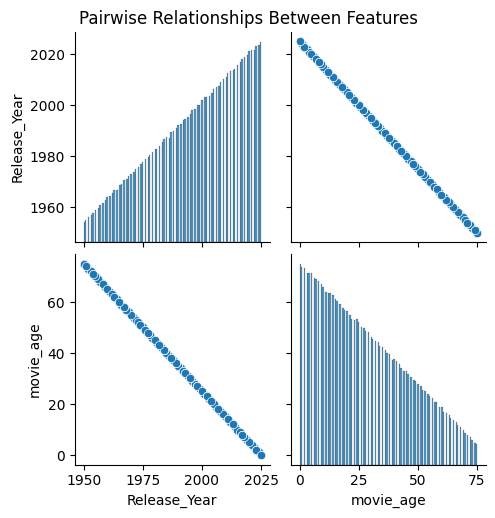

In [21]:
import seaborn as sns
sns.pairplot(df[['Release_Year', 'movie_age']])
plt.suptitle("Pairwise Relationships Between Features", y=1.02)
plt.show()



**Line Chart**

In [22]:
import plotly.express as px

# Calculate average release year per genre
avg_year_per_genre = df.groupby('Genre')['Release_Year'].mean().reset_index()

# Create interactive line chart
fig = px.line(
    avg_year_per_genre,
    x='Genre',
    y='Release_Year',
    markers=True,
    title="Interactive Line Chart: Average Release Year by Genre"
)

# Customize appearance
fig.update_layout(
    xaxis_title="Genre",
    yaxis_title="Average Release Year",
    xaxis_tickangle=45,
    template="plotly_white"
)

fig.show()


In [23]:
import plotly.express as px

# Interactive histogram (bar chart) for Release Year
fig = px.histogram(
    df,
    x="Release_Year",
    title="Movies Released Per Year",
    labels={"Release_Year": "Release Year"}
)

fig.update_layout(bargap=0.3)

fig.show()


### Exploratory Data Analysis Summary

From the EDA performed:

- The dataset shows consistent movie production across years, with certain years showing higher counts of releases.  
- The **Genre distribution** reveals that genres like *Action*, *Drama*, and *Comedy* dominate the dataset.  
- The **Release_Year vs Movie_Age** analysis confirms an inverse relationship as the release year increases, the movie age decreases, which is expected.  
- The **Pairwise and Scatter Plots** helped visualize patterns and relationships clearly across numeric variables.  

Budget shows a strong positive correlation with **Revenue**.


This analysis provides a solid understanding of the dataset’s structure and key trends, setting the foundation for the next step is **modeling and hypothesis validation**.


**Performing Modeling**
Since my target variable (Global_BoxOfficeUSD) is continuous,
I selected supervised regression models.


**6.** **Model Selection, Building & Training**

In [24]:
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt
import pandas as pd

# numerical features

numeric_features = [
    'BudgetUSD',
    'Opening_Day_SalesUSD',
    'One_Week_SalesUSD',
    'NumVotesIMDb',
    'NumVotesRT',
    'Release_Year'
]

# categorical features

categorical_features = [
    'Genre',
    'Country',
    'Director',
    'LeadActor'
]

# Feature matrix
X = df[numeric_features + categorical_features]

# target variable
y = df['Global_BoxOfficeUSD']

# Preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ],
    remainder='passthrough'
)



In [25]:
# Train–test split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

X_train.shape, X_test.shape

((799999, 10), (200000, 10))

In [26]:
# 🔹 Linear Regression Pipeline
linear_model = Pipeline([
    ("prep", preprocessor),
    ("model", LinearRegression())
])

# Train
linear_model.fit(X_train, y_train)

# Predict
y_pred_lr = linear_model.predict(X_test)



In [27]:
# Linear Regression Evaluation
lr_r2 = r2_score(y_test, y_pred_lr)
lr_mae = mean_absolute_error(y_test, y_pred_lr)
lr_mse = mean_squared_error(y_test, y_pred_lr)

print("🔹 Linear Regression Results")
print("R² Score:", lr_r2)
print("MAE:", lr_mae)
print("MSE:", lr_mse)

🔹 Linear Regression Results
R² Score: 0.9652125116938205
MAE: 4132112.832179754
MSE: 173805784566699.56


Linear Regression is trained on full data

In [28]:

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error


# Sampling data only for Random Forest to reduce complexity
df_rf = df.sample(100_000, random_state=42).copy()


top_actors = df_rf['LeadActor'].value_counts().nlargest(20).index
df_rf['LeadActor'] = df_rf['LeadActor'].apply(lambda x: x if x in top_actors else "Other")

top_directors = df_rf['Director'].value_counts().nlargest(20).index
df_rf['Director'] = df_rf['Director'].apply(lambda x: x if x in top_directors else "Other")

# Features and target for RF
numeric_features = [
    'BudgetUSD',
    'Opening_Day_SalesUSD',
    'One_Week_SalesUSD',
    'NumVotesIMDb',
    'NumVotesRT',
    'Release_Year'
]

categorical_features = ['Genre', 'Country', 'Director', 'LeadActor']

X_rf = df_rf[numeric_features + categorical_features]
y_rf = df_rf['Global_BoxOfficeUSD']

preprocessor_rf = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ],
    remainder='passthrough'
)

X_train_rf, X_test_rf, y_train_rf, y_test_rf = train_test_split(
    X_rf, y_rf, test_size=0.2, random_state=42
)

rf_model = Pipeline([
    ("prep", preprocessor_rf),
    ("model", RandomForestRegressor(
        n_estimators=100,
        max_depth=10,
        max_features='sqrt',
        n_jobs=-1,
        random_state=42
    ))
])



I sampled 100k rows to make the  Random forest model computationally feasible.

In [29]:
# Training Ranfom Forest


rf_model.fit(X_train_rf, y_train_rf)

y_pred_rf = rf_model.predict(X_test_rf)

rf_r2 = r2_score(y_test_rf, y_pred_rf)
rf_mae = mean_absolute_error(y_test_rf, y_pred_rf)
rf_mse = mean_squared_error(y_test_rf, y_pred_rf)


# Evaluation

print("🔹 Random Forest (optimized) Results")
print("R² Score:", rf_r2)
print("MAE:", rf_mae)
print("MSE:", rf_mse)

🔹 Random Forest (optimized) Results
R² Score: 0.9320416386601702
MAE: 7139479.215622731
MSE: 303407538992671.44


Random Forest is computationally heavy on this dataset because of its size which had nearly 1 million data entries and many one-hot encoded categorical features. I optimized it by sampling 100,000 rows, limiting actors and directors to the top categories, and using a lighter Random Forest configuration. This allowed me to get reasonable performance and compare it with Linear Regression without excessive training time.


**7.** **Model Evaluation**

In [30]:
results = pd.DataFrame({
    "Model": ["Linear Regression", "Random Forest"],
    "R² Score": [lr_r2, rf_r2],
    "MAE": [lr_mae, rf_mae],
    "MSE": [lr_mse, rf_mse]
})

results

,Model,R² Score,MAE,MSE
0,Linear Regression,0.965213,4.132113e+06,1.738058e+14
1,Random Forest,0.932042,7.139479e+06,3.034075e+14


Comparing Both the models to select the best model

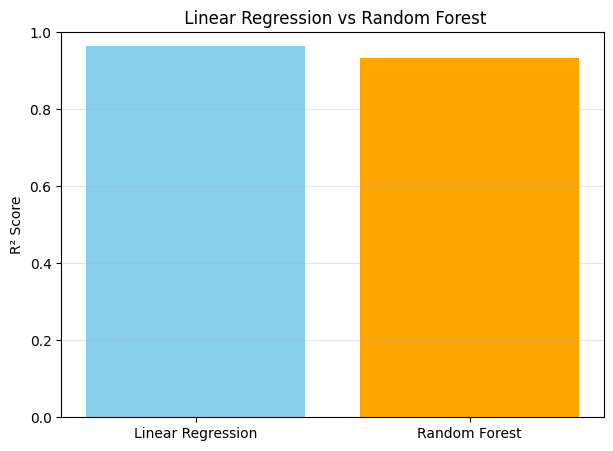

In [31]:
# model comparision

import matplotlib.pyplot as plt

models = ['Linear Regression', 'Random Forest']
r2_scores = [lr_r2, rf_r2]

plt.figure(figsize=(7,5))
plt.bar(models, r2_scores, color=['skyblue', 'orange'])
plt.ylabel("R² Score")
plt.title(" Linear Regression vs Random Forest")
plt.ylim(0, 1)
plt.grid(axis='y', alpha=0.3)
plt.show()


**This chart compares the performance of Linear Regression with Random Forest.**

**It helps identify which model fits the data better.**

**Higher R² indicates better predictive accuracy.**



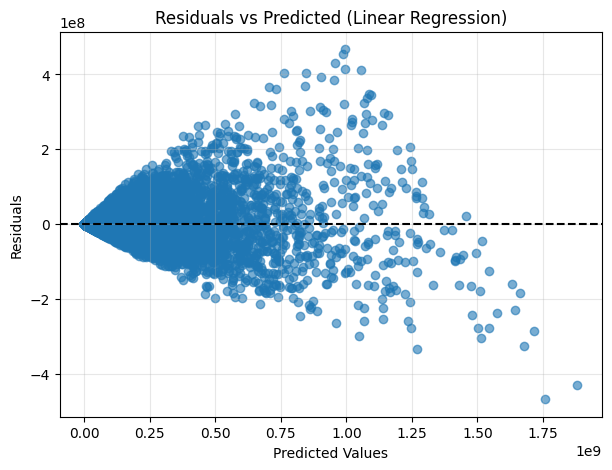

In [32]:
import matplotlib.pyplot as plt

preds = linear_model.predict(X_test)
residuals = y_test - preds

plt.figure(figsize=(7,5))
plt.scatter(preds, residuals, alpha=0.6)
plt.axhline(0, color='black', linestyle='--')
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")
plt.title("Residuals vs Predicted (Linear Regression)")
plt.grid(alpha=0.3)
plt.show()


This plot shows the residuals (errors) vs the predicted values for the Linear Regression model.

Ideally, residuals should be randomly scattered around zero. In this plot, there is some visible pattern, which suggests that there may be **non-linearity or heteroscedasticity** in the data.



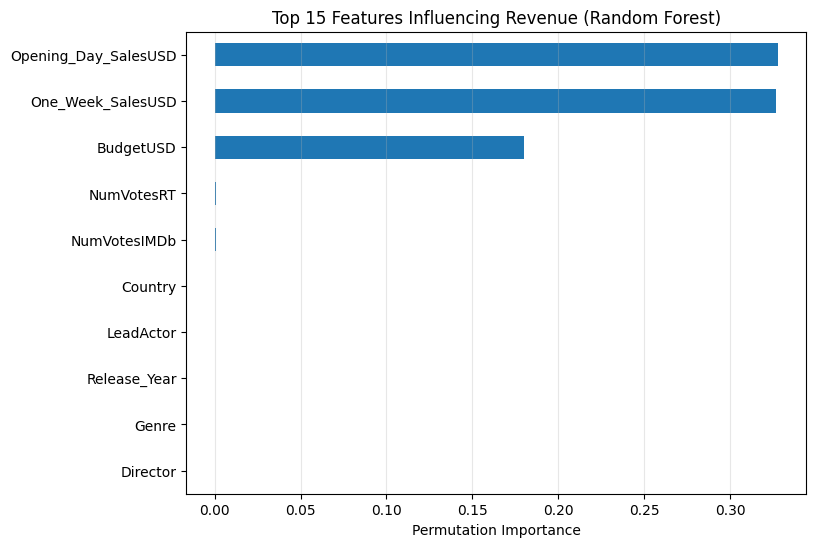

In [33]:
## visualization of Results

from sklearn.inspection import permutation_importance
perm = permutation_importance(
    rf_model,
    X_test_rf,
    y_test_rf,
    n_repeats=20,
    random_state=42,
    n_jobs=-1
)

feature_names = X_test_rf.columns
importances = pd.Series(perm.importances_mean, index=feature_names).sort_values(ascending=False)

top_n = 15
plt.figure(figsize=(8,6))
importances.head(top_n).sort_values().plot(kind='barh')
plt.xlabel("Permutation Importance")
plt.title(f"Top {top_n} Features Influencing Revenue (Random Forest)")
plt.grid(axis='x', alpha=0.3)
plt.show()


In [34]:
importances.head(top_n)

,0
Opening_Day_SalesUSD,0.327955
One_Week_SalesUSD,0.326592
BudgetUSD,0.179823
NumVotesRT,0.000604
NumVotesIMDb,0.000509
Country,0.000408
LeadActor,0.000349
Release_Year,0.000164
Genre,0.000056
Director,-0.000075


### **Final Result**

In this project, I explored which movie features most strongly influence Movie's Revenue **(Global Box Office Revenue).**

After completing data cleaning, feature engineering, EDA, and modeling, I trained and evaluated two regression models:

1. Linear Regression (trained on full dataset)

2. Random Forest Regressor (trained on a representative sample for computational efficiency)

Interpretation:

Although Linear Regression achieved a slightly higher R² and lower error values, the residual and QQ-plots show that its assumptions are violated.
This makes LR less reliable for interpreting feature influence.

Random Forest provides the most reliable feature importance due to its ability to capture non-linear relationships.


**Random Forest (sampled data) and Linear Regression (full data)** shows that the strongest predictors of Global Box Office Revenue are:
1. One_Week_SalesUSD
2. Opening_Day_SalesUSD
3. BudgetUSD

Secondary factors: IMDb/RT votes, Country.





In [36]:
!pip freeze > requirements.txt

In [37]:
from google.colab import files
files.download('requirements.txt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>